In [137]:
# !pip install git+https://github.com/qubvel/classification_models.git

In [138]:
from keras.optimizers import Adam
# from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, TensorBoard, Callback
from keras import backend as K
from keras.models import load_model
# from math import ceil
import numpy as np
from matplotlib import pyplot as plt

from keras.models import Model
# from keras.layers import Input, Lambda, Conv2D, MaxPooling2D, BatchNormalization, ELU, Reshape, Concatenate, Activation, UpSampling2D
# from keras.regularizers import l2
# from keras.engine.topology import InputSpec
# from keras.engine.topology import Layer

import tensorflow as tf
# import time

from classification_models.resnet import ResNet18, preprocess_input
# from classification_models.resnet import SEResNet18, preprocess_input

# from keras.utils import Sequence

from imgaug import augmenters as iaa
import imgaug as ia

from collections import defaultdict
# import warnings
import numpy as np
import cv2
import random
import sklearn.utils
# from copy import deepcopy
from PIL import Image
import os
import json

%matplotlib inline

In [139]:
img_height = 512 # Height of the input images  720x1280
img_width = 512 # Width of the input images
img_channels = 3 # Number of color channels of the input images
subtract_mean = 127.5 # Set this to your preference (maybe `None`). The current settings transform the input pixel values to the interval `[-1,1]`.
divide_by_stddev = 127.5 # Set this to your preference (maybe `None`). The current settings transform the input pixel values to the interval `[-1,1]`.
n_classes = 13 # Number of positive classes
scales = [0.08, 0.16, 0.32, 0.64, 0.96] # An explicit list of anchor box scaling factors. If this is passed, it will override `min_scale` and `max_scale`.
aspect_ratios = [0.3, 0.5, 1.0, 1.5, 2.0, 2.5] # The list of aspect ratios for the anchor boxes
two_boxes_for_ar1 = False # Whether or not you want to generate two anchor boxes for aspect ratio 1
steps = None # In case you'd like to set the step sizes for the anchor box grids manually; not recommended
offsets = None # # In case you'd like to set the offsets for the anchor box grids manually; not recommended
limit_boxes = True # Whether or not you want to limit the anchor boxes to lie entirely within the image boundaries
variances = [1.0, 1.0, 1.0, 1.0] # The list of variances by which the encoded target coordinates are scaled
coords = 'minmax' # Whether the box coordinates to be used should be in the 'centroids' or 'minmax' format, see documentation
normalize_coords = True # Whether or not the model is supposed to use relative coordinates that are within [0,1]
positive_thresh = 0.4
negative_thresh = 0.2
fx_scale = 1 #0.4  #0.175
fy_scale = 1 #0.711  #0.31

In [140]:
categories = ['LowCurbContrast', 'Ponding', 
              'Patching', 'EquipmentCrack', 
              'Debris', 'Corrosion', 
              'LowStepContrast', 'OverhangingVegetation', 
              'WrinkledMembrane', 'WalkwayCrack', 
              'BallastDisplacement', 
              'RoofMold', 'BlockedDrain']

INPUT_PHOTOS = "../input/damageroof/new_images/new_images/"
INPUT_LABELS = "../input/damageroof/labels/labels/"
model_path = "../input/fork-of-traffic-light/ssd7.h5"
object_for_detection = categories

In [141]:
#Getting lists with names of files 
def files(path_img, path_lab, object_detect):  
    input_images = []
    input_labels = []
    
    num = 0
    for file in os.listdir(path_img):
        
        if os.path.isfile(os.path.join(path_img, file)):
            
            if not os.path.isfile(path_lab + file.split('.')[0] + '.json'):
                continue
                
            count = 0
            with open(path_lab + file.split('.')[0] + '.json', 'r') as f:
                data = json.load(f)
                f.close()

                for piece in data["objects"]:  

                    if piece['category'] in object_detect:
                        # get coordinates
                        xmin = int(piece['box2d']['x1'])
                        ymin = int(piece['box2d']['y1'])
                        xmax = int(piece['box2d']['x2'])
                        ymax = int(piece['box2d']['y2'])
                        
                        if xmin < 0 or ymin < 0 or xmax < 0 or ymax < 0:
                            continue
                    
                        count = count + 1
                        
            if count > 0:
                num = num + 1
                input_images.append(os.path.join(path_img, file))
                file = file.split('.')[0] + '.json'
                input_labels.append(os.path.join(path_lab, file))  
        
    
    print(num)
    return input_images, input_labels

In [142]:
#Splitting data for test and train 
def split_test_train(data_x, data_y, percent):
    size_train = int(len(data_x) * percent)
    train_x = data_x[:size_train]
    train_y = data_y[:size_train]
    test_x = data_x[size_train:]
    test_y = data_y[size_train:]
    return train_x, train_y, test_x, test_y

In [143]:
class SSDLoss:

    def __init__(self,
                 neg_pos_ratio=3,
                 n_neg_min=0,
                 alpha=1.0):
        
        self.neg_pos_ratio = neg_pos_ratio
        self.n_neg_min = n_neg_min
        self.alpha = alpha

    def smooth_L1_loss(self, y_true, y_pred):
       
        absolute_loss = tf.abs(y_true - y_pred)
        square_loss = 0.5 * (y_true - y_pred)**2
        l1_loss = tf.where(tf.less(absolute_loss, 1.0), square_loss, absolute_loss - 0.5)
        return tf.reduce_sum(l1_loss, axis=-1)

    def log_loss(self, y_true, y_pred):
       
        # Make sure that `y_pred` doesn't contain any zeros (which would break the log function)
        y_pred = tf.maximum(y_pred, 1e-15)
        # Compute the log loss
        log_loss = -tf.reduce_sum(y_true * tf.log(y_pred), axis=-1)
        return log_loss

    def compute_loss(self, y_true, y_pred):
       
        self.neg_pos_ratio = tf.constant(self.neg_pos_ratio)
        self.n_neg_min = tf.constant(self.n_neg_min)
        self.alpha = tf.constant(self.alpha)

        batch_size = tf.shape(y_pred)[0] # Output dtype: tf.int32
        n_boxes = tf.shape(y_pred)[1] # Output dtype: tf.int32, note that `n_boxes` in this context denotes the total number of boxes per image, not the number of boxes per cell

        # 1: Compute the losses for class and box predictions for every box

        classification_loss = tf.to_float(self.log_loss(y_true[:,:,:-12], y_pred[:,:,:-12])) # Output shape: (batch_size, n_boxes)
        localization_loss = tf.to_float(self.smooth_L1_loss(y_true[:,:,-12:-8], y_pred[:,:,-12:-8])) # Output shape: (batch_size, n_boxes)

        # 2: Compute the classification losses for the positive and negative targets

        # Create masks for the positive and negative ground truth classes
        negatives = y_true[:,:,0] # Tensor of shape (batch_size, n_boxes)
        positives = tf.to_float(tf.reduce_max(y_true[:,:,1:-12], axis=-1)) # Tensor of shape (batch_size, n_boxes)

        # Count the number of positive boxes (classes 1 to n) in y_true across the whole batch
        n_positive = tf.reduce_sum(positives)
        pos_class_loss = tf.reduce_sum(classification_loss * positives, axis=-1) # Tensor of shape (batch_size,)

        # Compute the classification loss for the negative default boxes (if there are any)

        # First, compute the classification loss for all negative boxes
        neg_class_loss_all = classification_loss * negatives # Tensor of shape (batch_size, n_boxes)
        n_neg_losses = tf.count_nonzero(neg_class_loss_all, dtype=tf.int32) # The number of non-zero loss entries in `neg_class_loss_all`
        n_negative_keep = tf.minimum(tf.maximum(self.neg_pos_ratio * tf.to_int32(n_positive), self.n_neg_min), n_neg_losses)

        def f1():
            return tf.zeros([batch_size])
        # Otherwise compute the negative loss
        def f2():
            neg_class_loss_all_1D = tf.reshape(neg_class_loss_all, [-1]) # Tensor of shape (batch_size * n_boxes,)
            # ...and then we get the indices for the `n_negative_keep` boxes with the highest loss out of those...
            values, indices = tf.nn.top_k(neg_class_loss_all_1D, n_negative_keep, False) # We don't need sorting
            # ...and with these indices we'll create a mask...
            negatives_keep = tf.scatter_nd(tf.expand_dims(indices, axis=1), updates=tf.ones_like(indices, dtype=tf.int32), shape=tf.shape(neg_class_loss_all_1D)) # Tensor of shape (batch_size * n_boxes,)
            negatives_keep = tf.to_float(tf.reshape(negatives_keep, [batch_size, n_boxes])) # Tensor of shape (batch_size, n_boxes)
            # ...and use it to keep only those boxes and mask all other classification losses
            neg_class_loss = tf.reduce_sum(classification_loss * negatives_keep, axis=-1) # Tensor of shape (batch_size,)
            return neg_class_loss

        neg_class_loss = tf.cond(tf.equal(n_neg_losses, tf.constant(0)), f1, f2)

        class_loss = pos_class_loss + neg_class_loss # Tensor of shape (batch_size,)

        # 3: Compute the localization loss for the positive targets
        loc_loss = tf.reduce_sum(localization_loss * positives, axis=-1) # Tensor of shape (batch_size,)

        # 4: Compute the total loss

        total_loss = (class_loss + self.alpha * loc_loss) / tf.maximum(1.0, n_positive) # In case `n_positive == 0`
        total_loss *= tf.to_float(batch_size)

        return total_loss

In [144]:
def iou(boxes1, boxes2, coords='minmax'):
    
    if len(boxes1.shape) > 2: raise ValueError("boxes1 must have rank either 1 or 2, but has rank {}.".format(len(boxes1.shape)))
    if len(boxes2.shape) > 2: raise ValueError("boxes2 must have rank either 1 or 2, but has rank {}.".format(len(boxes2.shape)))

    if len(boxes1.shape) == 1: boxes1 = np.expand_dims(boxes1, axis=0)
    if len(boxes2.shape) == 1: boxes2 = np.expand_dims(boxes2, axis=0)

    if not (boxes1.shape[1] == boxes2.shape[1] == 4): raise ValueError("It must be boxes1.shape[1] == boxes2.shape[1] == 4, but it is boxes1.shape[1] == {}, boxes2.shape[1] == {}.".format(boxes1.shape[1], boxes2.shape[1]))

    if coords in {'minmax', 'centroids'}:
        intersection = np.maximum(0, np.minimum(boxes1[:,1], boxes2[:,1]) - np.maximum(boxes1[:,0], boxes2[:,0])) * np.maximum(0, np.minimum(boxes1[:,3], boxes2[:,3]) - np.maximum(boxes1[:,2], boxes2[:,2]))
        union = (boxes1[:,1] - boxes1[:,0]) * (boxes1[:,3] - boxes1[:,2]) + (boxes2[:,1] - boxes2[:,0]) * (boxes2[:,3] - boxes2[:,2]) - intersection
    elif coords == 'corners':
        intersection = np.maximum(0, np.minimum(boxes1[:,2], boxes2[:,2]) - np.maximum(boxes1[:,0], boxes2[:,0])) * np.maximum(0, np.minimum(boxes1[:,3], boxes2[:,3]) - np.maximum(boxes1[:,1], boxes2[:,1]))
        union = (boxes1[:,2] - boxes1[:,0]) * (boxes1[:,3] - boxes1[:,1]) + (boxes2[:,2] - boxes2[:,0]) * (boxes2[:,3] - boxes2[:,1]) - intersection

    return intersection / union

In [145]:
class AnchorBoxes(Layer):

    def __init__(self,
                 img_height,
                 img_width,
                 this_scale,
                 next_scale,
                 aspect_ratios=aspect_ratios,
                 two_boxes_for_ar1=True,
                 this_steps=None,
                 this_offsets=None,
                 limit_boxes=True,
                 variances=[1.0, 1.0, 1.0, 1.0],
                 coords='centroids',
                 normalize_coords=False,
                 **kwargs):
       
        if K.backend() != 'tensorflow':
            raise TypeError("This layer only supports TensorFlow at the moment, but you are using the {} backend.".format(K.backend()))

        if (this_scale < 0) or (next_scale < 0) or (this_scale > 1):
            raise ValueError("`this_scale` must be in [0, 1] and `next_scale` must be >0, but `this_scale` == {}, `next_scale` == {}".format(this_scale, next_scale))

        if len(variances) != 4:
            raise ValueError("4 variance values must be pased, but {} values were received.".format(len(variances)))
        variances = np.array(variances)
        if np.any(variances <= 0):
            raise ValueError("All variances must be >0, but the variances given are {}".format(variances))

        self.img_height = img_height
        self.img_width = img_width
        self.this_scale = this_scale
        self.next_scale = next_scale
        self.aspect_ratios = aspect_ratios
        self.two_boxes_for_ar1 = two_boxes_for_ar1
        self.this_steps = this_steps
        self.this_offsets = this_offsets
        self.limit_boxes = limit_boxes
        self.variances = variances
        self.coords = coords
        self.normalize_coords = normalize_coords
        # Compute the number of boxes per cell
        if (1 in aspect_ratios) and two_boxes_for_ar1:
            self.n_boxes = len(aspect_ratios) + 1
        else:
            self.n_boxes = len(aspect_ratios)
        super(AnchorBoxes, self).__init__(**kwargs)

    def build(self, input_shape):
        self.input_spec = [InputSpec(shape=input_shape)]
        super(AnchorBoxes, self).build(input_shape)

    def call(self, x, mask=None):
       
        # Compute box width and height for each aspect ratio
        # The shorter side of the image will be used to compute `w` and `h` using `scale` and `aspect_ratios`.
        size = min(self.img_height, self.img_width)
        # Compute the box widths and and heights for all aspect ratios
        wh_list = []
        for ar in self.aspect_ratios:
            if (ar == 1):
                # Compute the regular anchor box for aspect ratio 1.
                box_height = box_width = self.this_scale * size
                wh_list.append((box_width, box_height))
                if self.two_boxes_for_ar1:
                    # Compute one slightly larger version using the geometric mean of this scale value and the next.
                    box_height = box_width = np.sqrt(self.this_scale * self.next_scale) * size
                    wh_list.append((box_width, box_height))
            else:
                box_height = self.this_scale * size / np.sqrt(ar)
                box_width = self.this_scale * size * np.sqrt(ar)
                wh_list.append((box_width, box_height))
        wh_list = np.array(wh_list)

        # We need the shape of the input tensor
        if K.image_dim_ordering() == 'tf':
            batch_size, feature_map_height, feature_map_width, feature_map_channels = x._keras_shape
        else: # Not yet relevant since TensorFlow is the only supported backend right now, but it can't harm to have this in here for the future
            batch_size, feature_map_channels, feature_map_height, feature_map_width = x._keras_shape

        # Compute the grid of box center points. They are identical for all aspect ratios.

        # Compute the step sizes, i.e. how far apart the anchor box center points will be vertically and horizontally.
        if (self.this_steps is None):
            step_height = self.img_height / feature_map_height
            step_width = self.img_width / feature_map_width
        else:
            if isinstance(self.this_steps, (list, tuple)) and (len(self.this_steps) == 2):
                step_height = self.this_steps[0]
                step_width = self.this_steps[1]
            elif isinstance(self.this_steps, (int, float)):
                step_height = self.this_steps
                step_width = self.this_steps
        # Compute the offsets, i.e. at what pixel values the first anchor box center point will be from the top and from the left of the image.
        if (self.this_offsets is None):
            offset_height = 0.5
            offset_width = 0.5
        else:
            if isinstance(self.this_offsets, (list, tuple)) and (len(self.this_offsets) == 2):
                offset_height = self.this_offsets[0]
                offset_width = self.this_offsets[1]
            elif isinstance(self.this_offsets, (int, float)):
                offset_height = self.this_offsets
                offset_width = self.this_offsets
        # Now that we have the offsets and step sizes, compute the grid of anchor box center points.
        cy = np.linspace(offset_height * step_height, (offset_height + feature_map_height - 1) * step_height, feature_map_height)
        cx = np.linspace(offset_width * step_width, (offset_width + feature_map_width - 1) * step_width, feature_map_width)
        cx_grid, cy_grid = np.meshgrid(cx, cy)
        cx_grid = np.expand_dims(cx_grid, -1) # This is necessary for np.tile() to do what we want further down
        cy_grid = np.expand_dims(cy_grid, -1) # This is necessary for np.tile() to do what we want further down

        # Create a 4D tensor template of shape `(feature_map_height, feature_map_width, n_boxes, 4)`
        # where the last dimension will contain `(cx, cy, w, h)`
        boxes_tensor = np.zeros((feature_map_height, feature_map_width, self.n_boxes, 4))

        boxes_tensor[:, :, :, 0] = np.tile(cx_grid, (1, 1, self.n_boxes)) # Set cx
        boxes_tensor[:, :, :, 1] = np.tile(cy_grid, (1, 1, self.n_boxes)) # Set cy
        boxes_tensor[:, :, :, 2] = wh_list[:, 0] # Set w
        boxes_tensor[:, :, :, 3] = wh_list[:, 1] # Set h

        # Convert `(cx, cy, w, h)` to `(xmin, xmax, ymin, ymax)`
        boxes_tensor = convert_coordinates(boxes_tensor, start_index=0, conversion='centroids2corners')

        # If `limit_boxes` is enabled, clip the coordinates to lie within the image boundaries
        if self.limit_boxes:
            x_coords = boxes_tensor[:,:,:,[0, 2]]
            x_coords[x_coords >= self.img_width] = self.img_width - 1
            x_coords[x_coords < 0] = 0
            boxes_tensor[:,:,:,[0, 2]] = x_coords
            y_coords = boxes_tensor[:,:,:,[1, 3]]
            y_coords[y_coords >= self.img_height] = self.img_height - 1
            y_coords[y_coords < 0] = 0
            boxes_tensor[:,:,:,[1, 3]] = y_coords

        # If `normalize_coords` is enabled, normalize the coordinates to be within [0,1]
        if self.normalize_coords:
            boxes_tensor[:, :, :, [0, 2]] /= self.img_width
            boxes_tensor[:, :, :, [1, 3]] /= self.img_height

        # TODO: Implement box limiting directly for `(cx, cy, w, h)` so that we don't have to unnecessarily convert back and forth.
        if self.coords == 'centroids':
            # Convert `(xmin, ymin, xmax, ymax)` back to `(cx, cy, w, h)`.
            boxes_tensor = convert_coordinates(boxes_tensor, start_index=0, conversion='corners2centroids')
        elif self.coords == 'minmax':
            # Convert `(xmin, ymin, xmax, ymax)` to `(xmin, xmax, ymin, ymax).
            boxes_tensor = convert_coordinates(boxes_tensor, start_index=0, conversion='corners2minmax')

        # Create a tensor to contain the variances and append it to `boxes_tensor`. This tensor has the same shape
        # as `boxes_tensor` and simply contains the same 4 variance values for every position in the last axis.
        variances_tensor = np.zeros_like(boxes_tensor) # Has shape `(feature_map_height, feature_map_width, n_boxes, 4)`
        variances_tensor += self.variances # Long live broadcasting
        # Now `boxes_tensor` becomes a tensor of shape `(feature_map_height, feature_map_width, n_boxes, 8)`
        boxes_tensor = np.concatenate((boxes_tensor, variances_tensor), axis=-1)

        # Now prepend one dimension to `boxes_tensor` to account for the batch size and tile it along
        # The result will be a 5D tensor of shape `(batch_size, feature_map_height, feature_map_width, n_boxes, 8)`
        boxes_tensor = np.expand_dims(boxes_tensor, axis=0)
        boxes_tensor = K.tile(K.constant(boxes_tensor, dtype='float32'), (K.shape(x)[0], 1, 1, 1, 1))

        return boxes_tensor

    def compute_output_shape(self, input_shape):
        if K.image_dim_ordering() == 'tf':
            batch_size, feature_map_height, feature_map_width, feature_map_channels = input_shape
        else: # Not yet relevant since TensorFlow is the only supported backend right now, but it can't harm to have this in here for the future
            batch_size, feature_map_channels, feature_map_height, feature_map_width = input_shape
        return (batch_size, feature_map_height, feature_map_width, self.n_boxes, 8)

    def get_config(self):
        config = {
            'img_height': self.img_height,
            'img_width': self.img_width,
            'this_scale': self.this_scale,
            'next_scale': self.next_scale,
            'aspect_ratios': list(self.aspect_ratios),
            'two_boxes_for_ar1': self.two_boxes_for_ar1,
            'limit_boxes': self.limit_boxes,
            'variances': list(self.variances),
            'coords': self.coords,
            'normalize_coords': self.normalize_coords
        }
        base_config = super(AnchorBoxes, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

In [146]:
def convert_coordinates(tensor, start_index, conversion):
   
    ind = start_index
    tensor1 = np.copy(tensor).astype(np.float)
    if conversion == 'minmax2centroids':
        tensor1[..., ind] = (tensor[..., ind] + tensor[..., ind+1]) / 2.0 # Set cx
        tensor1[..., ind+1] = (tensor[..., ind+2] + tensor[..., ind+3]) / 2.0 # Set cy
        tensor1[..., ind+2] = tensor[..., ind+1] - tensor[..., ind] # Set w
        tensor1[..., ind+3] = tensor[..., ind+3] - tensor[..., ind+2] # Set h
    elif conversion == 'centroids2minmax':
        tensor1[..., ind] = tensor[..., ind] - tensor[..., ind+2] / 2.0 # Set xmin
        tensor1[..., ind+1] = tensor[..., ind] + tensor[..., ind+2] / 2.0 # Set xmax
        tensor1[..., ind+2] = tensor[..., ind+1] - tensor[..., ind+3] / 2.0 # Set ymin
        tensor1[..., ind+3] = tensor[..., ind+1] + tensor[..., ind+3] / 2.0 # Set ymax
    elif conversion == 'corners2centroids':
        tensor1[..., ind] = (tensor[..., ind] + tensor[..., ind+2]) / 2.0 # Set cx
        tensor1[..., ind+1] = (tensor[..., ind+1] + tensor[..., ind+3]) / 2.0 # Set cy
        tensor1[..., ind+2] = tensor[..., ind+2] - tensor[..., ind] # Set w
        tensor1[..., ind+3] = tensor[..., ind+3] - tensor[..., ind+1] # Set h
    elif conversion == 'centroids2corners':
        tensor1[..., ind] = tensor[..., ind] - tensor[..., ind+2] / 2.0 # Set xmin
        tensor1[..., ind+1] = tensor[..., ind+1] - tensor[..., ind+3] / 2.0 # Set ymin
        tensor1[..., ind+2] = tensor[..., ind] + tensor[..., ind+2] / 2.0 # Set xmax
        tensor1[..., ind+3] = tensor[..., ind+1] + tensor[..., ind+3] / 2.0 # Set ymax
    elif (conversion == 'minmax2corners') or (conversion == 'corners2minmax'):
        tensor1[..., ind+1] = tensor[..., ind+2]
        tensor1[..., ind+2] = tensor[..., ind+1]
    else:
        raise ValueError("Unexpected conversion value. Supported values are 'minmax2centroids', 'centroids2minmax', 'corners2centroids', 'centroids2corners', 'minmax2corners', and 'corners2minmax'.")

    return tensor1

In [147]:
class SSDBoxEncoder:
    
    def __init__(self,
                 img_height,
                 img_width,
                 n_classes,
                 predictor_sizes,
                 min_scale=0.1,
                 max_scale=0.9,
                 scales=None,
                 aspect_ratios_global=[0.5, 1.0, 2.0],
                 aspect_ratios_per_layer=None,
                 two_boxes_for_ar1=True,
                 steps=None,
                 offsets=None,
                 limit_boxes=False,
                 variances=[1.0, 1.0, 1.0, 1.0],
                 pos_iou_threshold=0.5,
                 neg_iou_threshold=0.3,
                 coords='centroids',
                 normalize_coords=False):
        
        predictor_sizes = np.array(predictor_sizes)
        if len(predictor_sizes.shape) == 1:
            predictor_sizes = np.expand_dims(predictor_sizes, axis=0)

        if (min_scale is None or max_scale is None) and scales is None:
            raise ValueError("Either `min_scale` and `max_scale` or `scales` need to be specified.")

        if scales:
            if (len(scales) != len(predictor_sizes)+1): # Must be two nested `if` statements since `list` and `bool` cannot be combined by `&`
                raise ValueError("It must be either scales is None or len(scales) == len(predictor_sizes)+1, but len(scales) == {} and len(predictor_sizes)+1 == {}".format(len(scales), len(predictor_sizes)+1))
            scales = np.array(scales)
            if np.any(scales <= 0):
                raise ValueError("All values in `scales` must be greater than 0, but the passed list of scales is {}".format(scales))
        else: # If no list of scales was passed, we need to make sure that `min_scale` and `max_scale` are valid values.
            if not 0 < min_scale <= max_scale:
                raise ValueError("It must be 0 < min_scale <= max_scale, but it is min_scale = {} and max_scale = {}".format(min_scale, max_scale))

        if not (aspect_ratios_per_layer is None):
            if (len(aspect_ratios_per_layer) != len(predictor_sizes)): # Must be two nested `if` statements since `list` and `bool` cannot be combined by `&`
                raise ValueError("It must be either aspect_ratios_per_layer is None or len(aspect_ratios_per_layer) == len(predictor_sizes), but len(aspect_ratios_per_layer) == {} and len(predictor_sizes) == {}".format(len(aspect_ratios_per_layer), len(predictor_sizes)))
            for aspect_ratios in aspect_ratios_per_layer:
                if np.any(np.array(aspect_ratios) <= 0):
                    raise ValueError("All aspect ratios must be greater than zero.")
        else:
            if (aspect_ratios_global is None):
                raise ValueError("At least one of `aspect_ratios_global` and `aspect_ratios_per_layer` must not be `None`.")
            if np.any(np.array(aspect_ratios_global) <= 0):
                raise ValueError("All aspect ratios must be greater than zero.")

        if len(variances) != 4:
            raise ValueError("4 variance values must be pased, but {} values were received.".format(len(variances)))
        variances = np.array(variances)
        if np.any(variances <= 0):
            raise ValueError("All variances must be >0, but the variances given are {}".format(variances))

        if neg_iou_threshold > pos_iou_threshold:
            raise ValueError("It cannot be `neg_iou_threshold > pos_iou_threshold`.")

        if not (coords == 'minmax' or coords == 'centroids' or coords == 'corners'):
            raise ValueError("Unexpected value for `coords`. Supported values are 'minmax', 'corners' and 'centroids'.")

        if (not (steps is None)) and (len(steps) != len(predictor_sizes)):
            raise ValueError("You must provide at least one step value per predictor layer.")

        if (not (offsets is None)) and (len(offsets) != len(predictor_sizes)):
            raise ValueError("You must provide at least one offset value per predictor layer.")

        self.img_height = img_height
        self.img_width = img_width
        self.n_classes = n_classes + 1
        self.predictor_sizes = predictor_sizes
        self.min_scale = min_scale
        self.max_scale = max_scale
        if (scales is None):
            self.scales = np.linspace(self.min_scale, self.max_scale, len(self.predictor_sizes)+1)
        else:
            # If a list of scales is given explicitly, we'll use that instead of computing it from `min_scale` and `max_scale`.
            self.scales = scales
        if (aspect_ratios_per_layer is None):
            self.aspect_ratios = [aspect_ratios_global] * len(predictor_sizes)
        else:
            # If aspect ratios are given per layer, we'll use those.
            self.aspect_ratios = aspect_ratios_per_layer
        self.two_boxes_for_ar1 = two_boxes_for_ar1
        if (not steps is None):
            self.steps = steps
        else:
            self.steps = [None] * len(predictor_sizes)
        if (not offsets is None):
            self.offsets = offsets
        else:
            self.offsets = [None] * len(predictor_sizes)
        self.limit_boxes = limit_boxes
        self.variances = variances
        self.pos_iou_threshold = pos_iou_threshold
        self.neg_iou_threshold = neg_iou_threshold
        self.coords = coords
        self.normalize_coords = normalize_coords

        # Compute the number of boxes per cell.
        if aspect_ratios_per_layer:
            self.n_boxes = []
            for aspect_ratios in aspect_ratios_per_layer:
                if (1 in aspect_ratios) & two_boxes_for_ar1:
                    self.n_boxes.append(len(aspect_ratios) + 1)
                else:
                    self.n_boxes.append(len(aspect_ratios))
        else:
            if (1 in aspect_ratios_global) & two_boxes_for_ar1:
                self.n_boxes = len(aspect_ratios_global) + 1
            else:
                self.n_boxes = len(aspect_ratios_global)

        self.boxes_list = [] # This will contain the anchor boxes for each predicotr layer.

        self.wh_list_diag = [] # Box widths and heights for each predictor layer
        self.steps_diag = [] # Horizontal and vertical distances between any two boxes for each predictor layer
        self.offsets_diag = [] # Offsets for each predictor layer
        self.centers_diag = [] # Anchor box center points as `(cy, cx)` for each predictor layer

        for i in range(len(self.predictor_sizes)):
            boxes, center, wh, step, offset = self.generate_anchor_boxes_for_layer(feature_map_size=self.predictor_sizes[i],
                                                                                   aspect_ratios=self.aspect_ratios[i],
                                                                                   this_scale=self.scales[i],
                                                                                   next_scale=self.scales[i+1],
                                                                                   this_steps=self.steps[i],
                                                                                   this_offsets=self.offsets[i],
                                                                                   diagnostics=True)
            self.boxes_list.append(boxes)
            self.wh_list_diag.append(wh)
            self.steps_diag.append(step)
            self.offsets_diag.append(offset)
            self.centers_diag.append(center)

    def generate_anchor_boxes_for_layer(self,
                                        feature_map_size,
                                        aspect_ratios,
                                        this_scale,
                                        next_scale,
                                        this_steps=None,
                                        this_offsets=None,
                                        diagnostics=False):
        
        # Compute box width and height for each aspect ratio.

        # The shorter side of the image will be used to compute `w` and `h` using `scale` and `aspect_ratios`.
        size = min(self.img_height, self.img_width)
        # Compute the box widths and and heights for all aspect ratios
        wh_list = []
        for ar in aspect_ratios:
            if (ar == 1):
                # Compute the regular anchor box for aspect ratio 1.
                box_height = box_width = this_scale * size
                wh_list.append((box_width, box_height))
                if self.two_boxes_for_ar1:
                    # Compute one slightly larger version using the geometric mean of this scale value and the next.
                    box_height = box_width = np.sqrt(this_scale * next_scale) * size
                    wh_list.append((box_width, box_height))
            else:
                box_width = this_scale * size * np.sqrt(ar)
                box_height = this_scale * size / np.sqrt(ar)
                wh_list.append((box_width, box_height))
        wh_list = np.array(wh_list)
        n_boxes = len(wh_list)

        # Compute the grid of box center points. They are identical for all aspect ratios.

        # Compute the step sizes, i.e. how far apart the anchor box center points will be vertically and horizontally.
        if (this_steps is None):
            step_height = self.img_height / feature_map_size[0]
            step_width = self.img_width / feature_map_size[1]
        else:
            if isinstance(this_steps, (list, tuple)) and (len(this_steps) == 2):
                step_height = this_steps[0]
                step_width = this_steps[1]
            elif isinstance(this_steps, (int, float)):
                step_height = this_steps
                step_width = this_steps
        # Compute the offsets, i.e. at what pixel values the first anchor box center point will be from the top and from the left of the image.
        if (this_offsets is None):
            offset_height = 0.5
            offset_width = 0.5
        else:
            if isinstance(this_offsets, (list, tuple)) and (len(this_offsets) == 2):
                offset_height = this_offsets[0]
                offset_width = this_offsets[1]
            elif isinstance(this_offsets, (int, float)):
                offset_height = this_offsets
                offset_width = this_offsets
        # Now that we have the offsets and step sizes, compute the grid of anchor box center points.
        cy = np.linspace(offset_height * step_height, (offset_height + feature_map_size[0] - 1) * step_height, feature_map_size[0])
        cx = np.linspace(offset_width * step_width, (offset_width + feature_map_size[1] - 1) * step_width, feature_map_size[1])
        cx_grid, cy_grid = np.meshgrid(cx, cy)
        cx_grid = np.expand_dims(cx_grid, -1) # This is necessary for np.tile() to do what we want further down
        cy_grid = np.expand_dims(cy_grid, -1) # This is necessary for np.tile() to do what we want further down

        # Create a 4D tensor template of shape `(feature_map_height, feature_map_width, n_boxes, 4)`
        # where the last dimension will contain `(cx, cy, w, h)`
        boxes_tensor = np.zeros((feature_map_size[0], feature_map_size[1], n_boxes, 4))

        boxes_tensor[:, :, :, 0] = np.tile(cx_grid, (1, 1, n_boxes)) # Set cx
        boxes_tensor[:, :, :, 1] = np.tile(cy_grid, (1, 1, n_boxes)) # Set cy
        boxes_tensor[:, :, :, 2] = wh_list[:, 0] # Set w
        boxes_tensor[:, :, :, 3] = wh_list[:, 1] # Set h

        # Convert `(cx, cy, w, h)` to `(xmin, ymin, xmax, ymax)`
        boxes_tensor = convert_coordinates(boxes_tensor, start_index=0, conversion='centroids2corners')

        # If `limit_boxes` is enabled, clip the coordinates to lie within the image boundaries
        if self.limit_boxes:
            x_coords = boxes_tensor[:,:,:,[0, 2]]
            x_coords[x_coords >= self.img_width] = self.img_width - 1
            x_coords[x_coords < 0] = 0
            boxes_tensor[:,:,:,[0, 2]] = x_coords
            y_coords = boxes_tensor[:,:,:,[1, 3]]
            y_coords[y_coords >= self.img_height] = self.img_height - 1
            y_coords[y_coords < 0] = 0
            boxes_tensor[:,:,:,[1, 3]] = y_coords

        # `normalize_coords` is enabled, normalize the coordinates to be within [0,1]
        if self.normalize_coords:
            boxes_tensor[:, :, :, [0, 2]] /= self.img_width
            boxes_tensor[:, :, :, [1, 3]] /= self.img_height

        # TODO: Implement box limiting directly for `(cx, cy, w, h)` so that we don't have to unnecessarily convert back and forth.
        if self.coords == 'centroids':
            # Convert `(xmin, ymin, xmax, ymax)` back to `(cx, cy, w, h)`.
            boxes_tensor = convert_coordinates(boxes_tensor, start_index=0, conversion='corners2centroids')
        elif self.coords == 'minmax':
            # Convert `(xmin, ymin, xmax, ymax)` to `(xmin, xmax, ymin, ymax).
            boxes_tensor = convert_coordinates(boxes_tensor, start_index=0, conversion='corners2minmax')

        if diagnostics:
            return boxes_tensor, (cy, cx), wh_list, (step_height, step_width), (offset_height, offset_width)
        else:
            return boxes_tensor

    def generate_encode_template(self, batch_size, diagnostics=False):
        
        # Tile the anchor boxes for each predictor layer across all batch items.
        boxes_batch = []
        for boxes in self.boxes_list:
            # Prepend one dimension to `self.boxes_list` to account for the batch size and tile it along.
            # The result will be a 5D tensor of shape `(batch_size, feature_map_height, feature_map_width, n_boxes, 4)`
            boxes = np.expand_dims(boxes, axis=0)
            boxes = np.tile(boxes, (batch_size, 1, 1, 1, 1))

            # Now reshape the 5D tensor above into a 3D tensor of shape
            # `(batch, feature_map_height * feature_map_width * n_boxes, 4)`. The resulting
            # order of the tensor content will be identical to the order obtained from the reshaping operation
            # in our Keras model (we're using the Tensorflow backend, and tf.reshape() and np.reshape()
            # use the same default index order, which is C-like index ordering)
            boxes = np.reshape(boxes, (batch_size, -1, 4))
            boxes_batch.append(boxes)

        # Concatenate the anchor tensors from the individual layers to one.
        boxes_tensor = np.concatenate(boxes_batch, axis=1)

        # 3: Create a template tensor to hold the one-hot class encodings of shape `(batch, #boxes, #classes)`
        #    It will contain all zeros for now, the classes will be set in the matching process that follows
        classes_tensor = np.zeros((batch_size, boxes_tensor.shape[1], self.n_classes))

        # 4: Create a tensor to contain the variances. This tensor has the same shape as `boxes_tensor` and simply
        #    contains the same 4 variance values for every position in the last axis.
        variances_tensor = np.zeros_like(boxes_tensor)
        variances_tensor += self.variances # Long live broadcasting

        # 4: Concatenate the classes, boxes and variances tensors to get our final template for y_encoded. We also need
        #    another tensor of the shape of `boxes_tensor` as a space filler so that `y_encode_template` has the same
        #    shape as the SSD model output tensor. The content of this tensor is irrelevant, we'll just use
        #    `boxes_tensor` a second time.
        y_encode_template = np.concatenate((classes_tensor, boxes_tensor, boxes_tensor, variances_tensor), axis=2)

        if diagnostics:
            return y_encode_template, self.centers_diag, self.wh_list_diag, self.steps_diag, self.offsets_diag
        else:
            return y_encode_template

    def encode_y(self, ground_truth_labels, diagnostics=False):
        
        # 1: Generate the template for y_encoded
        y_encode_template = self.generate_encode_template(batch_size=len(ground_truth_labels), diagnostics=False)
        y_encoded = np.copy(y_encode_template) # We'll write the ground truth box data to this array

        # 2: Match the boxes from `ground_truth_labels` to the anchor boxes in `y_encode_template`
        #    and for each matched box record the ground truth coordinates in `y_encoded`.
        #    Every time there is no match for a anchor box, record `class_id` 0 in `y_encoded` for that anchor box.

        class_vector = np.eye(self.n_classes) # An identity matrix that we'll use as one-hot class vectors

        for i in range(y_encode_template.shape[0]): # For each batch item...
            available_boxes = np.ones((y_encode_template.shape[1])) # 1 for all anchor boxes that are not yet matched to a ground truth box, 0 otherwise
            negative_boxes = np.ones((y_encode_template.shape[1])) # 1 for all negative boxes, 0 otherwise
            for true_box in ground_truth_labels[i]: # For each ground truth box belonging to the current batch item...
                true_box = np.array(true_box).astype(np.float)

                if abs(true_box[3] - true_box[1] < 0.001) or abs(true_box[4] - true_box[2] < 0.001): continue # Protect ourselves against bad ground truth data: boxes with width or height equal to zero
                if self.normalize_coords:
                    true_box[[1,3]] /= self.img_width # Normalize xmin and xmax to be within [0,1]
                    true_box[[2,4]] /= self.img_height # Normalize ymin and ymax to be within [0,1]
                if self.coords == 'centroids':
                    true_box = convert_coordinates(true_box, start_index=1, conversion='corners2centroids')
                elif self.coords == 'minmax':
                    true_box = convert_coordinates(true_box, start_index=1, conversion='corners2minmax')
                similarities = iou(y_encode_template[i,:,-12:-8], true_box[1:-1], coords=self.coords) # The iou similarities for all anchor boxes
                negative_boxes[similarities >= self.neg_iou_threshold] = 0 # If a negative box gets an IoU match >= `self.neg_iou_threshold`, it's no longer a valid negative box
                similarities *= available_boxes # Filter out anchor boxes which aren't available anymore (i.e. already matched to a different ground truth box)
                available_and_thresh_met = np.copy(similarities)
                available_and_thresh_met[available_and_thresh_met < self.pos_iou_threshold] = 0 # Filter out anchor boxes which don't meet the iou threshold
                assign_indices = np.nonzero(available_and_thresh_met)[0] # Get the indices of the left-over anchor boxes to which we want to assign this ground truth box
                if len(assign_indices) > 0: # If we have any matches
                    y_encoded[i,assign_indices,:-8] = np.concatenate((class_vector[int(true_box[0])], true_box[1:-1]), axis=0) # Write the ground truth box coordinates and class to all assigned anchor box positions. Remember that the last four elements of `y_encoded` are just dummy entries.
                    available_boxes[assign_indices] = 0 # Make the assigned anchor boxes unavailable for the next ground truth box
                else: # If we don't have any matches
                    best_match_index = np.argmax(similarities) # Get the index of the best iou match out of all available boxes
                    y_encoded[i,best_match_index,:-8] = np.concatenate((class_vector[int(true_box[0])], true_box[1:-1]), axis=0) # Write the ground truth box coordinates and class to the best match anchor box position
                    available_boxes[best_match_index] = 0 # Make the assigned anchor box unavailable for the next ground truth box
                    negative_boxes[best_match_index] = 0 # The assigned anchor box is no longer a negative box
            # Set the classes of all remaining available anchor boxes to class zero
            background_class_indices = np.nonzero(negative_boxes)[0]
            y_encoded[i,background_class_indices,0] = 1

        # 3: Convert absolute box coordinates to offsets from the anchor boxes and normalize them
        if self.coords == 'centroids':
            y_encoded[:,:,[-12,-11]] -= y_encode_template[:,:,[-12,-11]] # cx(gt) - cx(anchor), cy(gt) - cy(anchor)
            y_encoded[:,:,[-12,-11]] /= y_encode_template[:,:,[-10,-9]] * y_encode_template[:,:,[-4,-3]] # (cx(gt) - cx(anchor)) / w(anchor) / cx_variance, (cy(gt) - cy(anchor)) / h(anchor) / cy_variance
            y_encoded[:,:,[-10,-9]] /= y_encode_template[:,:,[-10,-9]] # w(gt) / w(anchor), h(gt) / h(anchor)
            y_encoded[:,:,[-10,-9]] = np.log(y_encoded[:,:,[-10,-9]]) / y_encode_template[:,:,[-2,-1]] # ln(w(gt) / w(anchor)) / w_variance, ln(h(gt) / h(anchor)) / h_variance (ln == natural logarithm)
        elif self.coords == 'corners':
            y_encoded[:,:,-12:-8] -= y_encode_template[:,:,-12:-8] # (gt - anchor) for all four coordinates
            y_encoded[:,:,[-12,-10]] /= np.expand_dims(y_encode_template[:,:,-10] - y_encode_template[:,:,-12], axis=-1) # (xmin(gt) - xmin(anchor)) / w(anchor), (xmax(gt) - xmax(anchor)) / w(anchor)
            y_encoded[:,:,[-11,-9]] /= np.expand_dims(y_encode_template[:,:,-9] - y_encode_template[:,:,-11], axis=-1) # (ymin(gt) - ymin(anchor)) / h(anchor), (ymax(gt) - ymax(anchor)) / h(anchor)
            y_encoded[:,:,-12:-8] /= y_encode_template[:,:,-4:] # (gt - anchor) / size(anchor) / variance for all four coordinates, where 'size' refers to w and h respectively
        else:
            y_encoded[:,:,-12:-8] -= y_encode_template[:,:,-12:-8] # (gt - anchor) for all four coordinates
            y_encoded[:,:,[-12,-11]] /= np.expand_dims(y_encode_template[:,:,-11] - y_encode_template[:,:,-12], axis=-1) # (xmin(gt) - xmin(anchor)) / w(anchor), (xmax(gt) - xmax(anchor)) / w(anchor)
            y_encoded[:,:,[-10,-9]] /= np.expand_dims(y_encode_template[:,:,-9] - y_encode_template[:,:,-10], axis=-1) # (ymin(gt) - ymin(anchor)) / h(anchor), (ymax(gt) - ymax(anchor)) / h(anchor)
            y_encoded[:,:,-12:-8] /= y_encode_template[:,:,-4:] # (gt - anchor) / size(anchor) / variance for all four coordinates, where 'size' refers to w and h respectively

        if diagnostics:
            # Here we'll save the matched anchor boxes (i.e. anchor boxes that were matched to a ground truth box, but keeping the anchor box coordinates).
            y_matched_anchors = np.copy(y_encoded)
            y_matched_anchors[:,:,-12:-8] = 0 # Keeping the anchor box coordinates means setting the offsets to zero.
            return y_encoded, y_matched_anchors
        else:
            return y_encoded
        
        
    def _greedy_nms2(self, predictions, iou_threshold=0.45, coords='corners'):
        '''
        The same greedy non-maximum suppression algorithm as above, but slightly modified for use as an internal
        function in `decode_y2()`.
        '''
        boxes_left = np.copy(predictions)
        maxima = [] # This is where we store the boxes that make it through the non-maximum suppression
        while boxes_left.shape[0] > 0: # While there are still boxes left to compare...
            maximum_index = np.argmax(boxes_left[:,1]) # ...get the index of the next box with the highest confidence...
            maximum_box = np.copy(boxes_left[maximum_index]) # ...copy that box and...
            maxima.append(maximum_box) # ...append it to `maxima` because we'll definitely keep it
            boxes_left = np.delete(boxes_left, maximum_index, axis=0) # Now remove the maximum box from `boxes_left`
            if boxes_left.shape[0] == 0: break # If there are no boxes left after this step, break. Otherwise...
            similarities = iou(boxes_left[:,2:], maximum_box[2:], coords=coords) # ...compare (IoU) the other left over boxes to the maximum box...
            boxes_left = boxes_left[similarities <= iou_threshold] # ...so that we can remove the ones that overlap too much with the maximum box
        return np.array(maxima)

    def decode_y2(self, y_pred,
                  confidence_thresh=0.5,
                  iou_threshold=0.45,
                  top_k='all',
                  input_coords='minmax',
                  normalize_coords=False,
                  img_height=None,
                  img_width=None):

        if normalize_coords and ((img_height is None) or (img_width is None)):
            raise ValueError("If relative box coordinates are supposed to be converted to absolute coordinates, the decoder needs the image size in order to decode the predictions, but `img_height == {}` and `img_width == {}`".format(img_height, img_width))

        # 1: Convert the classes from one-hot encoding to their class ID
        y_pred_converted = np.copy(y_pred[:,:,-14:-8]) # Slice out the four offset predictions plus two elements whereto we'll write the class IDs and confidences in the next step
        y_pred_converted[:,:,0] = np.argmax(y_pred[:,:,:-12], axis=-1) # The indices of the highest confidence values in the one-hot class vectors are the class ID
        y_pred_converted[:,:,1] = np.amax(y_pred[:,:,:-12], axis=-1) # Store the confidence values themselves, too

        # 2: Convert the box coordinates from the predicted anchor box offsets to predicted absolute coordinates
        if input_coords == 'centroids':
            y_pred_converted[:,:,[4,5]] = np.exp(y_pred_converted[:,:,[4,5]] * y_pred[:,:,[-2,-1]]) # exp(ln(w(pred)/w(anchor)) / w_variance * w_variance) == w(pred) / w(anchor), exp(ln(h(pred)/h(anchor)) / h_variance * h_variance) == h(pred) / h(anchor)
            y_pred_converted[:,:,[4,5]] *= y_pred[:,:,[-6,-5]] # (w(pred) / w(anchor)) * w(anchor) == w(pred), (h(pred) / h(anchor)) * h(anchor) == h(pred)
            y_pred_converted[:,:,[2,3]] *= y_pred[:,:,[-4,-3]] * y_pred[:,:,[-6,-5]] # (delta_cx(pred) / w(anchor) / cx_variance) * cx_variance * w(anchor) == delta_cx(pred), (delta_cy(pred) / h(anchor) / cy_variance) * cy_variance * h(anchor) == delta_cy(pred)
            y_pred_converted[:,:,[2,3]] += y_pred[:,:,[-8,-7]] # delta_cx(pred) + cx(anchor) == cx(pred), delta_cy(pred) + cy(anchor) == cy(pred)
            y_pred_converted = convert_coordinates(y_pred_converted, start_index=-4, conversion='centroids2corners')
        elif input_coords == 'minmax':
            y_pred_converted[:,:,2:] *= y_pred[:,:,-4:] # delta(pred) / size(anchor) / variance * variance == delta(pred) / size(anchor) for all four coordinates, where 'size' refers to w or h, respectively
            y_pred_converted[:,:,[2,3]] *= np.expand_dims(y_pred[:,:,-7] - y_pred[:,:,-8], axis=-1) # delta_xmin(pred) / w(anchor) * w(anchor) == delta_xmin(pred), delta_xmax(pred) / w(anchor) * w(anchor) == delta_xmax(pred)
            y_pred_converted[:,:,[4,5]] *= np.expand_dims(y_pred[:,:,-5] - y_pred[:,:,-6], axis=-1) # delta_ymin(pred) / h(anchor) * h(anchor) == delta_ymin(pred), delta_ymax(pred) / h(anchor) * h(anchor) == delta_ymax(pred)
            y_pred_converted[:,:,2:] += y_pred[:,:,-8:-4] # delta(pred) + anchor == pred for all four coordinates
            y_pred_converted = convert_coordinates(y_pred_converted, start_index=-4, conversion='minmax2corners')
        elif input_coords == 'corners':
            y_pred_converted[:,:,2:] *= y_pred[:,:,-4:] # delta(pred) / size(anchor) / variance * variance == delta(pred) / size(anchor) for all four coordinates, where 'size' refers to w or h, respectively
            y_pred_converted[:,:,[2,4]] *= np.expand_dims(y_pred[:,:,-6] - y_pred[:,:,-8], axis=-1) # delta_xmin(pred) / w(anchor) * w(anchor) == delta_xmin(pred), delta_xmax(pred) / w(anchor) * w(anchor) == delta_xmax(pred)
            y_pred_converted[:,:,[3,5]] *= np.expand_dims(y_pred[:,:,-5] - y_pred[:,:,-7], axis=-1) # delta_ymin(pred) / h(anchor) * h(anchor) == delta_ymin(pred), delta_ymax(pred) / h(anchor) * h(anchor) == delta_ymax(pred)
            y_pred_converted[:,:,2:] += y_pred[:,:,-8:-4] # delta(pred) + anchor == pred for all four coordinates
        else:
            raise ValueError("Unexpected value for `coords`. Supported values are 'minmax', 'corners' and 'centroids'.")

        # 3: If the model predicts normalized box coordinates and they are supposed to be converted back to absolute coordinates, do that
        if normalize_coords:
            y_pred_converted[:,:,[2,4]] *= img_width # Convert xmin, xmax back to absolute coordinates
            y_pred_converted[:,:,[3,5]] *= img_height # Convert ymin, ymax back to absolute coordinates

        # 4: Decode our huge `(batch, #boxes, 6)` tensor into a list of length `batch` where each list entry is an array containing only the positive predictions
        y_pred_decoded = []

        for batch_item in y_pred_converted: # For each image in the batch...
            boxes = batch_item[np.nonzero(batch_item[:,0])] # ...get all boxes that don't belong to the background class,...
            boxes = boxes[boxes[:,1] >= confidence_thresh] # ...then filter out those positive boxes for which the prediction confidence is too low and after that...
            if iou_threshold: # ...if an IoU threshold is set...
                boxes = self._greedy_nms2(boxes, iou_threshold=iou_threshold, coords='corners') # ...perform NMS on the remaining boxes.
            if top_k != 'all' and boxes.shape[0] > top_k: # If we have more than `top_k` results left at this point...
                top_k_indices = np.argpartition(boxes[:,1], kth=boxes.shape[0]-top_k, axis=0)[boxes.shape[0]-top_k:] # ...get the indices of the `top_k` highest-scoring boxes...
                boxes = boxes[top_k_indices] # ...and keep only those boxes...
            y_pred_decoded.append(boxes) # ...and now that we're done, append the array of final predictions for this batch item to the output list

        return y_pred_decoded

In [148]:
ssd_loss = SSDLoss(neg_pos_ratio=2, n_neg_min=0, alpha=1.0)

K.clear_session()

model = load_model(model_path, custom_objects={'AnchorBoxes': AnchorBoxes,
                                               'compute_loss': ssd_loss.compute_loss})

In [149]:
ia.seed(1)
sometimes = lambda aug: iaa.Sometimes(0.5, aug)

class DataParser():
    
    def __init__(self, object_detect, filenames_type='text'):
        self.box_output_format = ['class_id', 'xmin', 'ymin', 'xmax', 'ymax', 'image_id']
        self.object_detect = object_detect
    
    def parse_json(self, image_filenames, img_labels):
        
        self.image_filenames = image_filenames
        self.img_labels = img_labels
        # Erase data that might have been parsed before.
        self.filenames = []
        self.image_ids = []
        self.labels = []
        
        count = 1

        # Iterate over all datasets.
        for images_dir, annotations_filename in zip(self.image_filenames, self.img_labels):
            with open(annotations_filename, 'r') as f:
                annotations = json.load(f)
            
            self.filenames.append(images_dir)
            self.image_ids.append(count)
            count = count + 1

            boxes = []
            for piece in annotations["objects"]:        

                if piece['category'] in self.object_detect:
                    # get coordinates
                    xmin = int(piece['box2d']['x1'] * fx_scale)
                    ymin = int(piece['box2d']['y2'] * fy_scale)
                    xmax = int(piece['box2d']['x2'] * fx_scale)
                    ymax = int(piece['box2d']['y1'] * fy_scale)
                    
                    if xmin < 0 or ymin < 0 or xmax < 0 or ymax < 0 or xmin > xmax or ymin > ymax:
                            continue
                    
                    # check for valid bounding boxes
                    assert xmin >= 0.0 and xmin <= xmax, \
                        'Invalid bounding box x-coord xmin {} or xmax {}' \
                            .format(xmin, xmax)
                    assert ymin >= 0.0 and ymin <= ymax, \
                        'Invalid bounding box y-coord ymin {} or ymax {}' \
                            .format(ymin, ymax)
                    
                    item_dict = {'class_id': object_for_detection.index(piece['category']) + 1,
                                 'xmin': xmin,
                                 'ymin': ymin,
                                 'xmax': xmax,
                                 'ymax': ymax,
                                 'image_id': count}
                    box = []
                    for item in self.box_output_format:
                        box.append(item_dict[item])
                    boxes.append(box)

            self.labels.append(boxes)
        
        return self.filenames, self.labels


In [150]:
predictor_sizes = [model.get_layer('classes4').output_shape[1:3],
                   model.get_layer('classes5').output_shape[1:3],
                   model.get_layer('classes6').output_shape[1:3],
                   model.get_layer('classes7').output_shape[1:3]]

print(predictor_sizes)

[(30, 30), (14, 14), (14, 14), (14, 14)]


In [151]:
ssd_box_encoder = SSDBoxEncoder(img_height=img_height,
                                img_width=img_width,
                                n_classes=n_classes, 
                                predictor_sizes=predictor_sizes,
                                scales=scales,
                                aspect_ratios_global=aspect_ratios,
                                aspect_ratios_per_layer=None,
                                two_boxes_for_ar1=two_boxes_for_ar1,
                                steps=steps,
                                offsets=offsets,
                                limit_boxes=limit_boxes,
                                variances=variances,
                                pos_iou_threshold=positive_thresh,
                                neg_iou_threshold=negative_thresh,
                                coords=coords,
                                normalize_coords=normalize_coords)

In [152]:
class DataGenerator(Sequence):

    def __init__(self, image_filenames, labels, batch_size):
        
        self.image_filenames, self.labels = image_filenames, labels
        self.box_output_format = ['class_id', 'xmin', 'ymin', 'xmax', 'ymax', 'image_id']
        self.batch_size = batch_size
        
    def __len__(self):
        return len(self.image_filenames) // self.batch_size - 1

    
    def __getitem__(self, idx):
        
        batch_x = self.image_filenames[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_y = self.labels[idx * self.batch_size:(idx + 1) * self.batch_size]
        
        batch_X = []

        # Find out the indices of the box coordinates in the label data
        xmin = self.box_output_format.index('xmin')
        ymin = self.box_output_format.index('ymin')
        xmax = self.box_output_format.index('xmax')
        ymax = self.box_output_format.index('ymax')
        ios = np.amin([xmin, ymin, xmax, ymax]) # Index offset, we need this for the inverse coordinate transform indices.        
      
        for filename in batch_x:
            with Image.open(filename) as img:
                img = cv2.resize(np.asarray(img), (img_height, img_width))
                batch_X.append(np.asarray(img))

        # Create the array that is to contain the inverse coordinate transformation values for this batch.
        batch_inverse_coord_transform = np.array([[[0, 1]] * 4] * self.batch_size, dtype=np.float32) # Array of shape `(batch_size, 4, 2)`, where the last axis contains an additive and a multiplicative scalar transformation constant.

        batch_items_to_remove = [] # In case we need to remove any images from the batch because of failed random cropping, store their indices in this list.

        for i in range(len(batch_X)):
            if not batch_y is None:
                # If this image has no ground truth boxes, maybe we don't want to keep it in the batch.
                if (len(batch_y[i]) == 0):
                    batch_items_to_remove.append(i)
                # Convert labels into an array (in case it isn't one already), otherwise the indexing below breaks.
                batch_y[i] = np.asarray(batch_y[i])

            if (batch_X[i].ndim == 2) and convert_to_3_channels:
                # Convert the 1-channel image into a 3-channel image.
                batch_X[i] = np.stack([batch_X[i]] * 3, axis=-1)

        batch_X = np.asarray(batch_X)
        batch_X = preprocess_input(batch_X)
#         batch_X = self.seq.augment_images(batch_X)

        batch_y_true = ssd_box_encoder.encode_y(batch_y, diagnostics=False) # Encode the labels into the `y_true` tensor that the SSD loss function needs.

        return batch_X, batch_y_true

In [153]:
colors = ['blue', 'red', 'black', 'black', 'pink', 'orange', 'blue', 'red', 'red', 'black', 'pink', 'orange', 'violet']

def visualize(object_for_detection, step):
    
    plt.figure(figsize=(20,50))
    
    print(object_for_detection, 'object_for_detection\n')
    input_images, input_labels = files(INPUT_PHOTOS, INPUT_LABELS, object_for_detection)
    train_image, train_labels, test_image, test_labels = split_test_train(input_images, input_labels, 0.7)

    val_dataset = DataParser(object_for_detection)
    val_filenames, val_train = val_dataset.parse_json(test_image,test_labels)
    n_val_samples = len(val_filenames)
    print(n_val_samples)
    
    batch_size = 10 if (n_val_samples > 10) else n_val_samples 
    test_gen = DataGenerator(val_filenames, val_train, batch_size)
    
    X, y_true = test_gen.__getitem__(step)
    y_pred = model.predict(X)

    y_pred_decoded = ssd_box_encoder.decode_y2(y_pred,
                           confidence_thresh=0.3,
                           iou_threshold=0.3,
                           top_k='all',
                           input_coords='minmax',
                           normalize_coords=True,
                           img_height=img_height,
                           img_width=img_width)

    np.set_printoptions(precision=2, suppress=True, linewidth=90)   

    

    for i in range(len(X)):

        img = X[i]

        print("i: ")
        print(i)  
        print("Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):\n")
        print(y_pred_decoded[i])  

        plt.subplot('52' + str(i))
        plt.imshow(X[i])

        current_axis = plt.gca()   

        classes = ['background'] + object_for_detection # Just so we can print class names onto the image instead of IDs

        # Draw the predicted boxes in blue
        for box in y_pred_decoded[i]:
            if categories[int(box[0]) - 1] in object_for_detection:
                xmin = box[-4]
                ymin = box[-3]
                xmax = box[-2]
                ymax = box[-1]
                label = '{}: {:.2f}'.format(categories[int(box[0]) - 1], box[1])
                current_axis.add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color=colors[int(box[0]) - 1], fill=False, linewidth=2))  
                current_axis.text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':colors[int(box[0]) - 1], 'alpha':1.0})

    plt.show()

['LowCurbContrast'] object_for_detection

2
1
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]


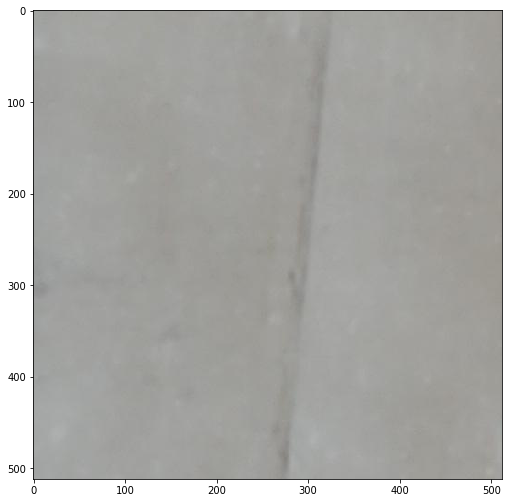

['Ponding'] object_for_detection

1399
420
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 11.     1.   -12.5  163.44 328.81 420.55]
 [ 11.     0.99 226.71 184.12 498.28 357.34]
 [ 11.     0.98 262.27 196.31 518.18 246.81]
 [ 11.     0.95 174.   139.62 276.39 453.87]
 [ 11.     0.88 294.89 104.86 509.02 276.63]
 [ 11.     0.71 118.54  11.08 407.46 363.67]
 [ 11.     0.69  15.17 265.07 255.53 341.08]
 [ 11.     0.61 -53.15 330.73 219.66 394.66]
 [ 11.     0.58  49.47 246.03 363.71 302.37]
 [  2.     0.54   8.12 143.79 125.68 536.51]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  2.     0.73   8.02 310.94  93.34 385.76]
 [  2.     0.57   6.58 339.37 139.72 440.43]]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
3
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  2.     0.69 121.96 144.21 187.42

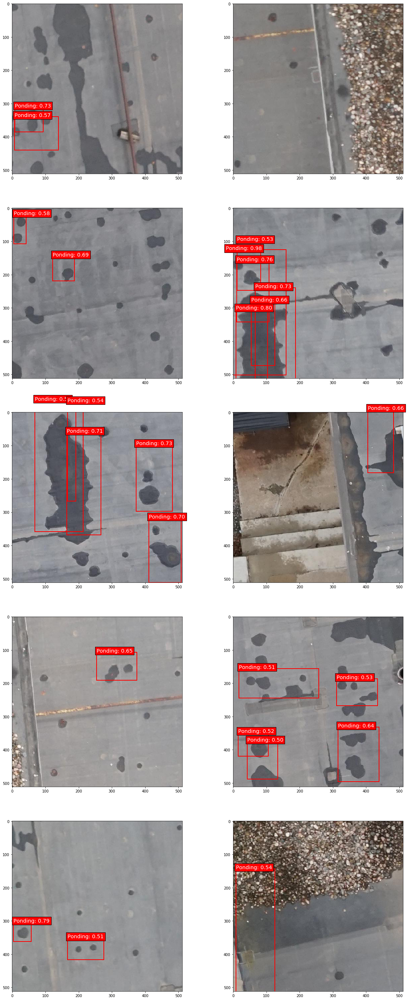

['Patching'] object_for_detection

288
87
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  3.     0.8  289.68 443.33 515.11 513.58]
 [  3.     0.73 161.71 440.69 395.85 546.53]
 [  3.     0.69  20.87 249.83 202.47 637.29]
 [  3.     0.67 355.39 362.73 549.18 487.23]
 [  3.     0.65 298.68 450.05 418.82 469.19]
 [  3.     0.62 215.16 400.24 519.93 448.81]
 [  3.     0.61  60.08 348.26 477.42 568.26]
 [  3.     0.55 251.52 474.8  425.18 495.25]
 [  3.     0.55 275.82 472.99 402.82 474.3 ]
 [  3.     0.55  74.69 435.3  261.39 525.03]
 [  3.     0.5  100.19 439.78 421.45 451.36]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  3.     0.72 269.98 128.96 412.53 424.21]
 [  3.     0.5  319.17 156.51 434.22 289.92]
 [  3.     0.5  199.32 103.1  465.1  239.99]]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  3.     0.63 342.95 136.73 437.26 362.01]

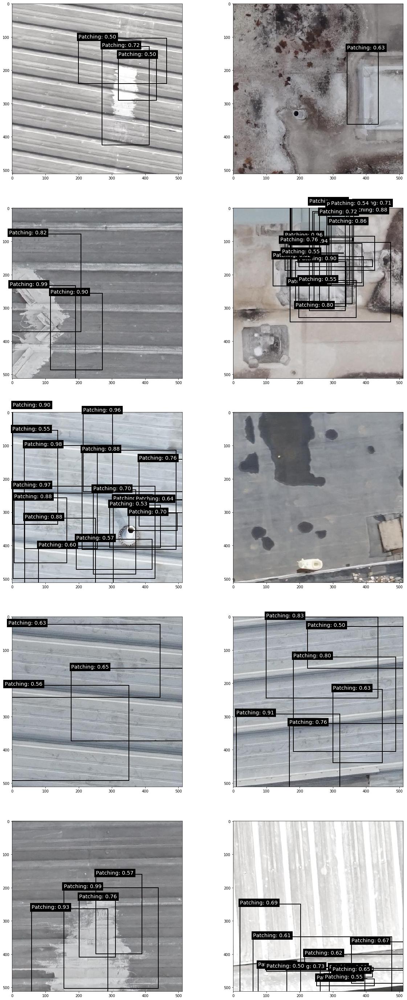

['EquipmentCrack'] object_for_detection

6
2
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]


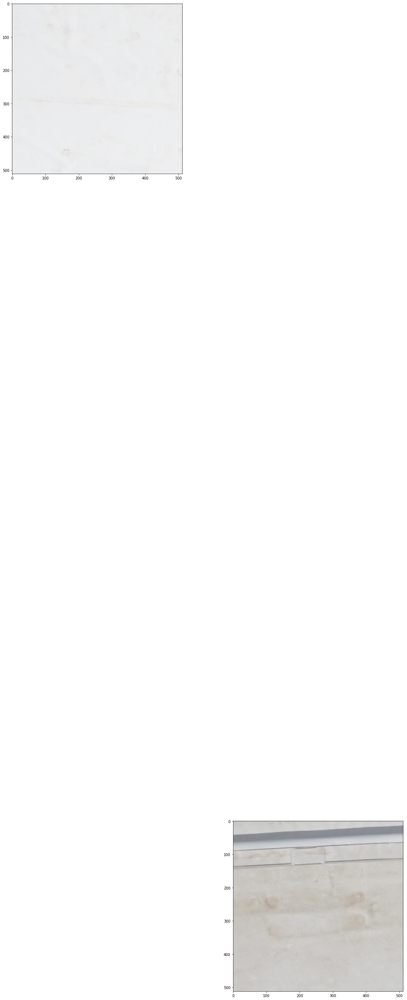

['Debris'] object_for_detection

29
9
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 11.     0.58 153.14 202.67 377.64 504.89]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  2.     0.53 -51.02 455.9  157.53 525.54]]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  2.     0.96 124.28 183.72 208.97 444.45]
 [  2.     0.94  80.12 170.07 135.86 461.15]
 [  2.     0.93  30.33  94.61 233.46 405.83]
 [  2.     0.79   0.1  114.8   95.7  364.69]
 [  2.     0.77 109.99 119.87 159.47 421.52]
 [  2.     0.59  94.07 114.05 115.51 400.14]
 [  2.     0.53 149.43 -19.37 258.75 630.89]
 [  2.     0.5  235.57  92.85 314.98 177.73]]
i: 
3
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
4
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  2.     0.65 155.19 104.19 236.43

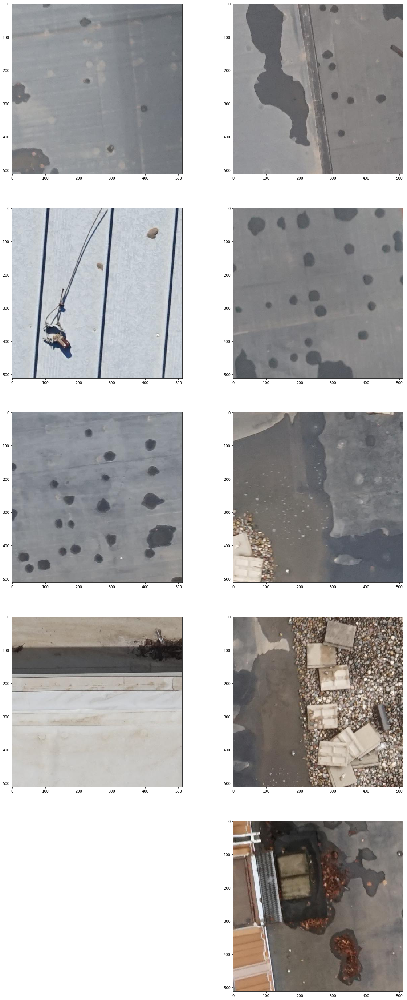

['Corrosion'] object_for_detection

192
58
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  6.     0.99   5.73  67.43 452.6  340.81]
 [  6.     0.94 115.85 216.73 507.8  429.67]
 [  6.     0.94 182.57   4.67 542.76 245.53]
 [  6.     0.71 307.9   79.4  446.52 242.8 ]
 [  6.     0.69 182.99 150.4  410.4  281.27]
 [  6.     0.63 177.08 170.68 289.47 424.55]
 [  6.     0.6  207.86 292.32 430.96 515.14]
 [  6.     0.6  152.06  77.27 369.88 218.63]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[   6.      1.    211.4   139.62  506.54  470.32]
 [   6.      1.    -11.86  145.04  292.72  476.61]
 [   6.      0.97   -5.58  205.2   115.8   561.16]
 [   6.      0.96  381.58  136.3   540.05  389.37]
 [   6.      0.68  -31.   -109.38  167.07  398.51]
 [   6.      0.47  135.88  261.97  379.23  502.73]]
i: 


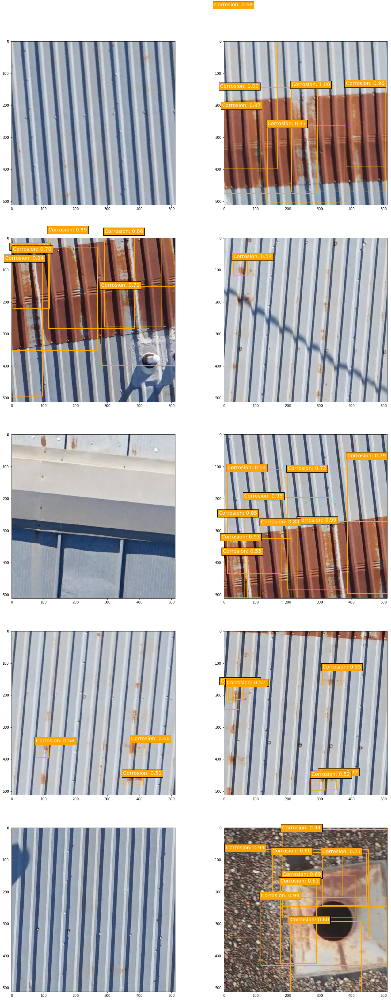

['LowStepContrast'] object_for_detection

3
1
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  2.     0.87  24.89 227.62 398.31 500.92]
 [  2.     0.85  38.26 369.52 255.22 501.58]
 [  3.     0.79 370.99 106.32 484.51 408.44]
 [  2.     0.53  55.15 151.2  225.26 386.9 ]
 [  2.     0.5  196.08 288.23 277.94 558.43]]


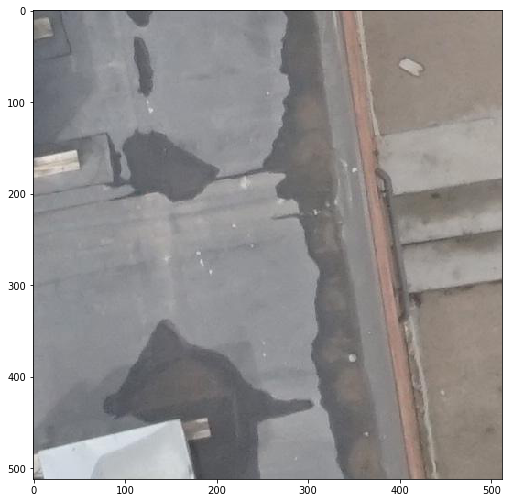

['OverhangingVegetation'] object_for_detection

34
11
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  8.     1.   148.27   0.91 432.36 372.85]
 [  8.     1.     3.84 -59.7  273.2  343.45]
 [  8.     0.99  -2.23  79.16 163.07 538.14]
 [  8.     0.97 -43.38  49.17 183.85 223.67]
 [  8.     0.97 301.48  39.   548.82 424.88]
 [  8.     0.82 128.   -20.54 283.36 179.77]
 [  8.     0.71 256.84 -48.15 501.77 196.94]
 [  8.     0.71  14.21 255.58 331.74 607.23]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  8.     0.82 207.88 142.25 416.61 302.44]
 [  8.     0.79 114.65   4.57 469.06 291.35]
 [  8.     0.68  -8.3   38.22 148.27 443.67]
 [  8.     0.55 259.07  57.81 569.3  443.89]]
i: 
3
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  8.     0.93  19.21 25

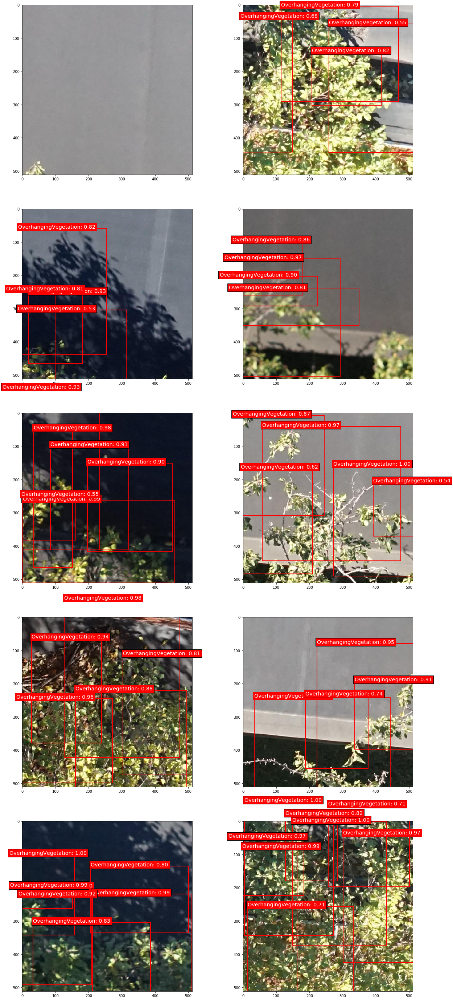

['WrinkledMembrane'] object_for_detection

2171
652
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  9.     0.6  297.19  49.37 454.17 169.52]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
3
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
4
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  9.     0.95 365.79 144.7  458.14 388.72]
 [  9.     0.86 367.73 216.66 551.61 275.42]
 [  9.     0.73 393.67 228.69 519.62 406.77]
 [  9.     0.66 410.68  38.98 517.24 167.06]
 [  9.     0.53 329.85  13.78 450.48 278.64]
 [  9.     0.53 411.97 171.58 497.53 307.28]
 [  9.     0.51 315.39 136.08 401.32 323.41]]
i: 
5
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
6
Deco

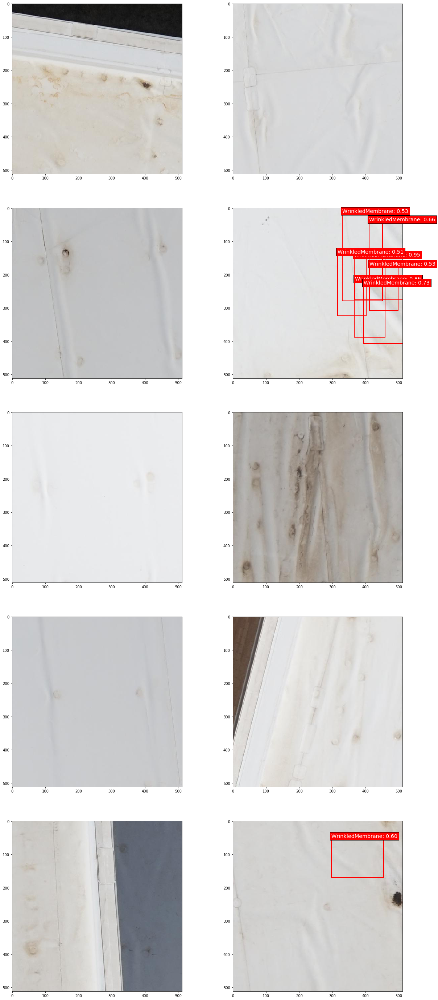

['WalkwayCrack'] object_for_detection

365
110
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 10.     0.87 365.97 187.38 526.48 360.02]
 [ 10.     0.86 372.03 282.99 484.84 411.53]
 [ 10.     0.81 259.58   6.02 419.92 187.34]
 [ 10.     0.8  426.86 258.3  447.3  393.64]
 [ 10.     0.78 404.97 302.89 558.05 482.63]
 [ 10.     0.78 352.62 429.67 496.77 528.25]
 [ 10.     0.76 335.77   6.36 523.07 501.39]
 [ 10.     0.74 295.   136.2  488.92 247.2 ]
 [ 10.     0.7  421.63 391.74 519.05 472.6 ]
 [ 10.     0.67 193.78  69.21 344.52 218.58]
 [ 10.     0.65 122.66 -30.34 317.55 167.11]
 [ 10.     0.64 305.68 166.91 411.29 315.58]
 [ 10.     0.56 297.26 345.92 511.99 382.65]
 [ 10.     0.56 404.75 304.67 436.89 444.19]
 [ 10.     0.55 484.32 133.24 576.45 379.12]
 [ 10.     0.52 311.07  90.61 347.16 205.88]]
i: 
2
Decoded predictions (output format 

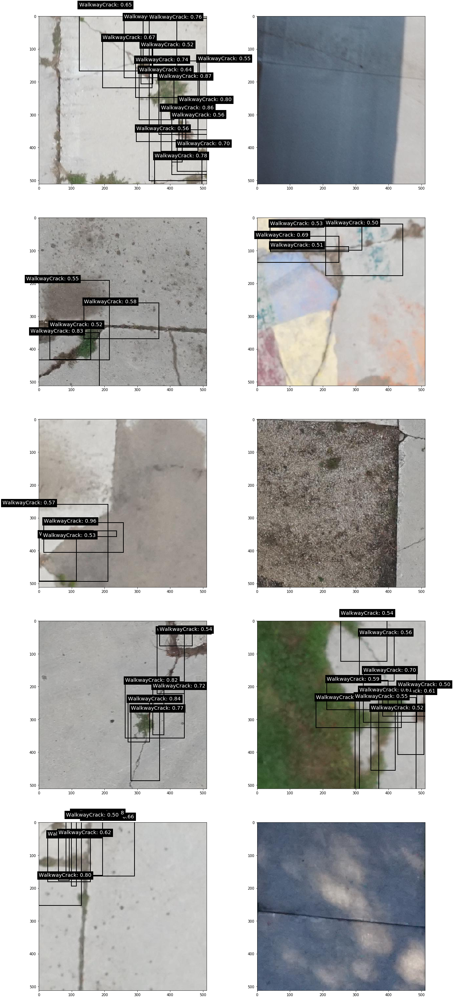

['BallastDisplacement'] object_for_detection

537
162
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 11.     0.93 363.22 -29.97 541.55 471.54]
 [ 11.     0.87 422.1  166.93 569.99 348.01]
 [ 11.     0.86 285.37  79.79 465.98 246.34]
 [ 11.     0.77 188.93 147.57 562.11 195.93]
 [ 11.     0.71 149.28 163.29 503.49 262.44]
 [ 11.     0.64 370.89 118.91 503.14 299.13]
 [ 11.     0.61 294.67 169.02 477.69 213.76]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 11.     0.97   2.38 201.68 330.57 405.58]
 [ 11.     0.63 -38.72 -32.08 210.89 391.11]
 [ 11.     0.58 208.44 131.93 524.79 331.96]]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 11.     1.   -12.5  163.44 328.81 420.55]
 [ 11.     0.99 226.71 184.12 498.28 357.34]
 [ 11.     0.98 262.27 196.31 518.18 246.81]
 [ 11.     0.95 174.   139.62 276.39 453.87]
 [ 11.     0.88 294.89 104.86 50

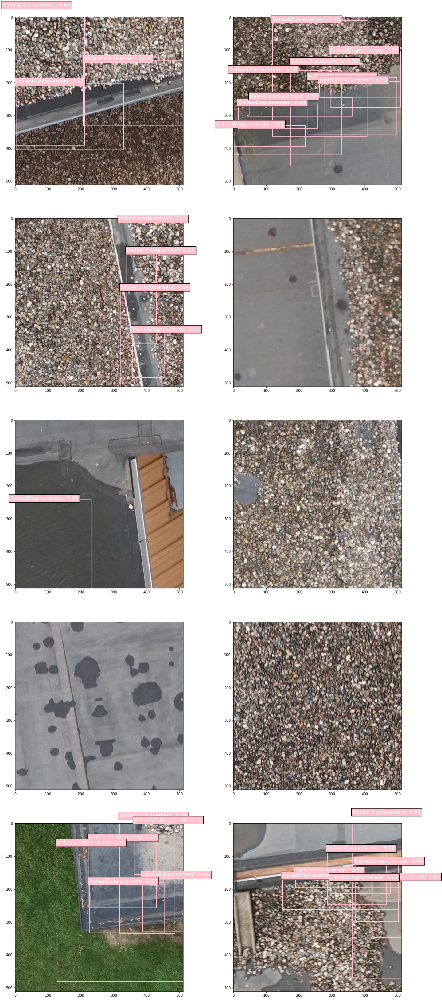

['RoofMold'] object_for_detection

718
216
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 12.     0.71   1.23 -10.05 147.63 396.51]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 12.     0.8    7.57  58.67 167.   382.27]]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 12.     0.57  13.13 227.79  84.38 435.78]]
i: 
3
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
4
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 12.     0.86  -3.46  41.65 252.95 288.06]
 [ 12.     0.86 120.9   35.37 355.94 199.19]
 [ 12.     0.6  275.07 358.4  493.3  509.62]
 [ 12.     0.51  83.37 121.9  236.76 219.29]]
i: 
5
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 12.     0.99  57.12 163.76 324.77 379.67]
 [ 12.     0.93 -29.48 123

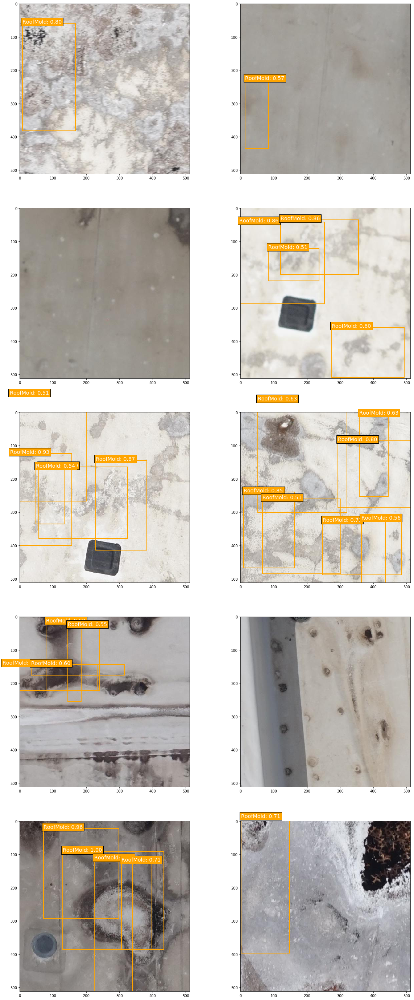

['BlockedDrain'] object_for_detection

28
9
i: 
0
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[  2.     1.   122.37 -22.88 200.95 421.21]
 [  2.     0.99 102.61  94.18 295.08 316.87]
 [  2.     0.99  21.81 133.7  294.08 551.5 ]
 [  2.     0.96  33.91  60.41 159.88 416.98]
 [  2.     0.96 175.35 221.72 331.96 451.39]
 [  2.     0.81 226.39  -1.07 281.72 295.28]
 [  2.     0.66 188.51 -32.01 369.31 298.86]
 [  2.     0.58 -14.71 123.86 104.58 314.66]
 [  2.     0.57  61.59 248.83 150.73 592.49]]
i: 
1
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[]
i: 
2
Decoded predictions (output format is [class_id, confidence, xmin, ymin, xmax, ymax]):

[[ 11.     0.9   14.55   8.62 190.67 157.02]
 [ 11.     0.84  -4.09  43.07 158.21 336.6 ]
 [ 11.     0.79 397.78  94.85 519.41 183.7 ]
 [ 11.     0.7  -48.64  25.78 150.46  91.22]
 [ 11.     0.69  46.12 213.54 215.25 478.93]
 [ 11.     0.53 -18.71 -14.89  88.61 196

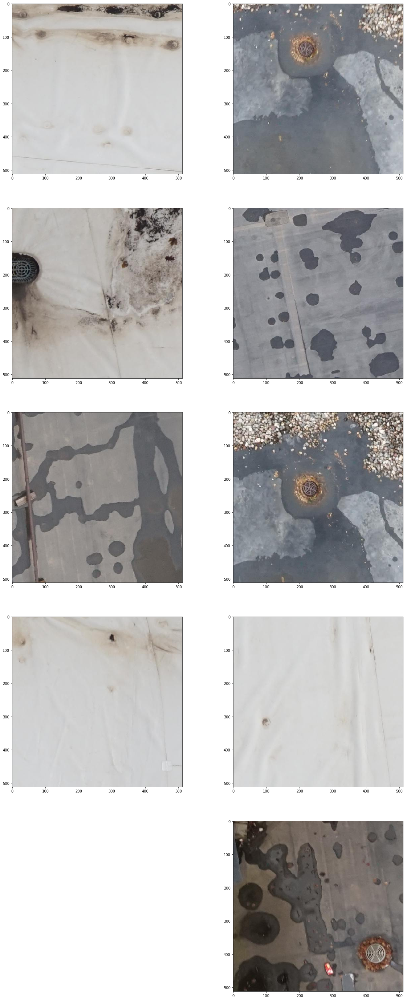

In [154]:
for i in range(len(object_for_detection)):
    visualize([object_for_detection[i]], 0)

In [155]:
# for i in range(len(object_for_detection)//2):
#     visualize(object_for_detection, i)